In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import display
from PIL import Image
import math

In [3]:
def detect_and_match_keypoints(img1, img2):
    sift = cv2.SIFT_create()

    gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

                                                                            
    keypoints1, descriptors1 = sift.detectAndCompute(gray1, None)
    keypoints2, descriptors2 = sift.detectAndCompute(gray2, None)     # Detect keypoints and descriptors

    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    matches = bf.match(descriptors1, descriptors2)                   # Brute-Force Matcher

    matched_image = cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches[:50], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    print("matched keypoints: ")
    display(Image.fromarray(matched_image))

    matches = sorted(matches, key=lambda x: x.distance)              # Sort matches by distance (best first)

    return keypoints1, keypoints2, matches

In [5]:
def get_homography(img1, img2):
    keypoints1, keypoints2, matches = detect_and_match_keypoints(img1, img2)

    if len(matches) < 10:
        raise ValueError("Not enough matches found.")

    src_pts = np.float32([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)    # Extract point coordinates from matches

    
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)        # Compute homography matrix

    return H


In [7]:
def stitch_two_images(img1, img2):
    H = get_homography(img1, img2)

    height1, width1 = img1.shape[:2]
    height2, width2 = img2.shape[:2]          # Get image dimensions

    warped_img1 = cv2.warpPerspective(img1, H, (width1 + width2, max(height1, height2)))     # Warp img1

    
    mask = (img2 > 0).astype(np.uint8) # Blending - Add img2 on top without shape mismatch , Create mask where img2 exists
    warped_img1[:height2, :width2] = warped_img1[:height2, :width2] * (1 - mask) + img2 * mask

    return warped_img1


In [9]:
def stitch_three_images(img1, img2, img3):
    stitched_1_2 = stitch_two_images(img1, img2)  
    panorama = stitch_two_images(stitched_1_2, img3) 

    return panorama


matched keypoints: 


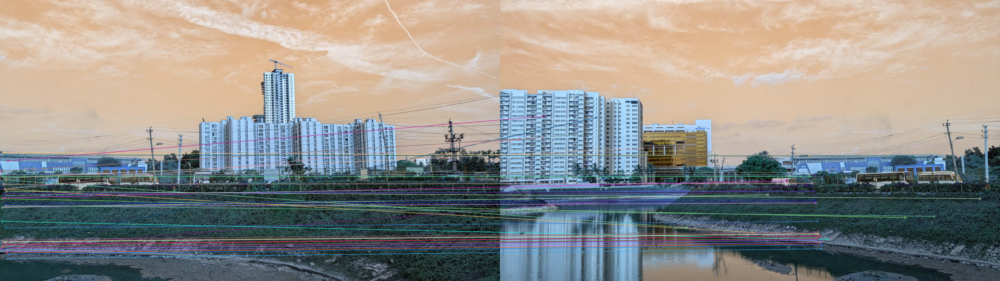

matched keypoints: 


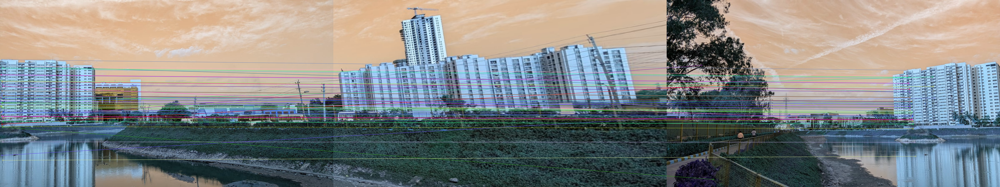

final_output


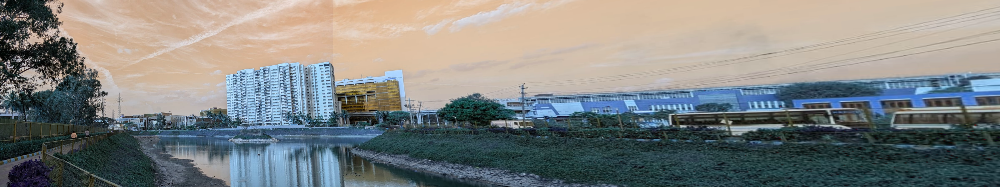

True

In [11]:
img1 = cv2.imread("panorama/Image1.jpeg")
img2 = cv2.imread("panorama/Image2.jpeg")
img3 = cv2.imread("panorama/Image3.jpeg")

final_panorama = stitch_three_images(img1, img2, img3)
print("final_output")
display(Image.fromarray(final_panorama))
cv2.imwrite("output/panorama_output.jpg", final_panorama)            # final Image